# **Sale Price Study**

## Objectives

This notebook fulfills business requirement 1: 
* exploring the correlation between house attributes and sale prices. To achieve this objective, we will:

    * Analyze the data to identify relevant variables
    * Conduct a correlation study between these variables and the sale price
    * Create visualizations to illustrate the correlations
    * Summarize the findings and provide insights on the relationship between house attributes and sale prices.

## Inputs

* outputs/datasets/collection/house_price_records.csv

## Outputs

* Generate code that answers business requirement 1 and can later be used to build a Streamlit App 

## CRISP-DM

* "Data Understanding"


---

# Change working directory

To run the notebooks in the editor, we need to change the working directory from its current folder to its parent folder.

* We access the current directory with os.getcwd()

In [1]:
import os
current_dir = os.getcwd()
current_dir

'/workspaces/heritage-housing-issues/jupyter_notebooks'

We want to make the parent of the current directory the new current directory
* os.path.dirname() gets the parent directory
* os.chir() defines the new current directory

In [2]:
os.chdir(os.path.dirname(current_dir))
print("You set a new current directory")

You set a new current directory


Confirm the new current directory

In [3]:
current_dir = os.getcwd()
current_dir

'/workspaces/heritage-housing-issues'

# Load Data

In [4]:
import pandas as pd
df = (pd.read_csv("outputs/datasets/collection/house_prices_records.csv"))
df.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,EnclosedPorch,GarageArea,GarageFinish,...,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,WoodDeckSF,YearBuilt,YearRemodAdd,SalePrice
0,856,854.0,3.0,No,706,GLQ,150,0.0,548,RFn,...,65.0,196.0,61,5,7,856,0.0,2003,2003,208500
1,1262,0.0,3.0,Gd,978,ALQ,284,NaN,460,RFn,...,80.0,0.0,0,8,6,1262,NaN,1976,1976,181500
2,920,866.0,3.0,Mn,486,GLQ,434,0.0,608,RFn,...,68.0,162.0,42,5,7,920,NaN,2001,2002,223500
3,961,NaN,NaN,No,216,ALQ,540,NaN,642,Unf,...,60.0,0.0,35,5,7,756,NaN,1915,1970,140000
4,1145,NaN,4.0,Av,655,GLQ,490,0.0,836,RFn,...,84.0,350.0,84,5,8,1145,NaN,2000,2000,250000


---

# Data Exploration

Our objective is to gain a comprehensive understanding of the dataset by examining variable types, distributions, missing values, and their significance in a business context.

In [5]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df=df, minimal=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Handling Missing Values

We first identify the variables with missing data using the `.isna()` `.sum()` method.

* Explore missing data

In [6]:
vars_with_missing_data = df.columns[df.isna().sum() > 0]
print("Variables with missing data:")
print(vars_with_missing_data)

Variables with missing data:
Index(['2ndFlrSF', 'BedroomAbvGr', 'BsmtFinType1', 'EnclosedPorch',
       'GarageFinish', 'GarageYrBlt', 'LotFrontage', 'MasVnrArea',
       'WoodDeckSF'],
      dtype='object')


* Identify categorical variables with missing data

In [7]:
categorical_missing_vars = df[vars_with_missing_data].select_dtypes(include='object').columns.tolist()
print("Categorical variables with missing data:")
print(categorical_missing_vars)


Categorical variables with missing data:
['BsmtFinType1', 'GarageFinish']


* Impute missing values in categorical variables

In [8]:
from feature_engine.imputation import CategoricalImputer
categorical_imputer = CategoricalImputer(imputation_method='frequent', variables=categorical_missing_vars)
df[categorical_missing_vars] = categorical_imputer.fit_transform(df[categorical_missing_vars])

* Verify the imputed categorical variables

In [9]:
print("Information of imputed categorical variables:")
print(df[categorical_missing_vars].info())

Information of imputed categorical variables:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   BsmtFinType1  1460 non-null   object
 1   GarageFinish  1460 non-null   object
dtypes: object(2)
memory usage: 22.9+ KB
None


---

# Correlation study

We perform a correlation study on the dataset to identify the top correlated variables with the 'SalePrice'.

* Apply one-hot encoding to separate object types into binary values, and display the initial information

In [10]:
from feature_engine.encoding import OneHotEncoder
encoder = OneHotEncoder(variables=df.select_dtypes(include='object').columns.tolist(), drop_last=False)
df_ohe = encoder.fit_transform(df)
print("Shape of the encoded DataFrame:", df_ohe.shape)
print("First few rows of the encoded DataFrame:")
print(df_ohe.head())

Shape of the encoded DataFrame: (1460, 40)
First few rows of the encoded DataFrame:
   1stFlrSF  2ndFlrSF  BedroomAbvGr  BsmtFinSF1  BsmtUnfSF  EnclosedPorch  \
0       856     854.0           3.0         706        150            0.0   
1      1262       0.0           3.0         978        284            NaN   
2       920     866.0           3.0         486        434            0.0   
3       961       NaN           NaN         216        540            NaN   
4      1145       NaN           4.0         655        490            0.0   

   GarageArea  GarageYrBlt  GrLivArea  LotArea  ...  BsmtFinType1_None  \
0         548       2003.0       1710     8450  ...                  0   
1         460       1976.0       1262     9600  ...                  0   
2         608       2001.0       1786    11250  ...                  0   
3         642       1998.0       1717     9550  ...                  0   
4         836       2000.0       2198    14260  ...                  0   

   BsmtF

* Calculate and display correlations using Spearman method

In [11]:
corr_spearman = df_ohe.corr(method='spearman')['SalePrice'].sort_values(key=abs, ascending=False)[1:].head(10)
print("Top correlations using Spearman method:")
print(corr_spearman)

Top correlations using Spearman method:
OverallQual       0.809829
GrLivArea         0.731310
YearBuilt         0.652682
GarageArea        0.649379
TotalBsmtSF       0.602725
GarageYrBlt       0.593788
KitchenQual_TA   -0.581803
1stFlrSF          0.575408
YearRemodAdd      0.571159
KitchenQual_Gd    0.478583
Name: SalePrice, dtype: float64


* Calculate and display correlations using Pearson method

In [12]:
corr_pearson = df_ohe.corr(method='pearson')['SalePrice'].sort_values(key=abs, ascending=False)[1:].head(10)
print("Top correlations using Pearson method:")
print(corr_pearson)

Top correlations using Pearson method:
OverallQual       0.790982
GrLivArea         0.708624
GarageArea        0.623431
TotalBsmtSF       0.613581
1stFlrSF          0.605852
YearBuilt         0.522897
KitchenQual_TA   -0.519298
YearRemodAdd      0.507101
KitchenQual_Ex    0.504094
GarageYrBlt       0.486362
Name: SalePrice, dtype: float64


* Select the top correlated variables to study

In [13]:
top_n = 5
relevant_variables = set(corr_pearson[:top_n].index.to_list() + corr_spearman[:top_n].index.to_list())
print("Variables to study:")
print(relevant_variables)

Variables to study:
{'1stFlrSF', 'YearBuilt', 'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'OverallQual'}


## EDA on selected variables

In [14]:
df_eda = df.filter(list(relevant_variables) + ['SalePrice'])
df_eda.head()

,1stFlrSF,YearBuilt,GarageArea,GrLivArea,TotalBsmtSF,OverallQual,SalePrice
0,856,2003,548,1710,856,7,208500
1,1262,1976,460,1262,1262,6,181500
2,920,2001,608,1786,920,7,223500
3,961,1915,642,1717,756,7,140000
4,1145,2000,836,2198,1145,8,250000


##  Analyzing Correlations

#### Analyze the data to identify relevant variables

In [15]:
corr_matrix = df.corr(method='pearson')
corr_with_saleprice = corr_matrix['SalePrice'].abs().sort_values(ascending=False)

# Select top correlated variables (excluding 'SalePrice' itself)
relevant_variables = corr_with_saleprice[1:7].index.tolist()

print("Relevant Variables:")
print(relevant_variables)

Relevant Variables:
['OverallQual', 'GrLivArea', 'GarageArea', 'TotalBsmtSF', '1stFlrSF', 'YearBuilt']


#### Investigate correlations between variables and 'SalePrice'

In [16]:
corr_pearson = df.corr(method='pearson')['SalePrice'].filter(relevant_variables)
corr_pearson_abs = corr_pearson.abs().sort_values(ascending=False)
top_correlations = corr_pearson_abs.head(6)
top_correlations_cols = top_correlations.index.tolist()

print("Top Correlated Variables:")
print(top_correlations_cols)

Top Correlated Variables:
['OverallQual', 'GrLivArea', 'GarageArea', 'TotalBsmtSF', '1stFlrSF', 'YearBuilt']


* Conduct a correlation study between these variables and the sale price

In [17]:
correlation_data = df[top_correlations_cols + ['SalePrice']].corr(method='pearson')

print("Correlation Coefficients:")
print(correlation_data)

Correlation Coefficients:
             OverallQual  GrLivArea  GarageArea  TotalBsmtSF  1stFlrSF  \
OverallQual     1.000000   0.593007    0.562022     0.537808  0.476224   
GrLivArea       0.593007   1.000000    0.468997     0.454868  0.566024   
GarageArea      0.562022   0.468997    1.000000     0.486665  0.489782   
TotalBsmtSF     0.537808   0.454868    0.486665     1.000000  0.819530   
1stFlrSF        0.476224   0.566024    0.489782     0.819530  1.000000   
YearBuilt       0.572323   0.199010    0.478954     0.391452  0.281986   
SalePrice       0.790982   0.708624    0.623431     0.613581  0.605852   

             YearBuilt  SalePrice  
OverallQual   0.572323   0.790982  
GrLivArea     0.199010   0.708624  
GarageArea    0.478954   0.623431  
TotalBsmtSF   0.391452   0.613581  
1stFlrSF      0.281986   0.605852  
YearBuilt     1.000000   0.522897  
SalePrice     0.522897   1.000000  


* Based on these correlation coefficients, we can conclude that the variables 'OverallQual', 'GrLivArea', 'GarageArea', 'TotalBsmtSF', 'YearBuilt' and '1stFlrSF' are positively correlated with 'SalePrice', meaning that as these variables increase, the sale price of the house tends to increase as well.

#### Plot scatter plots for top correlated variables

In [18]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

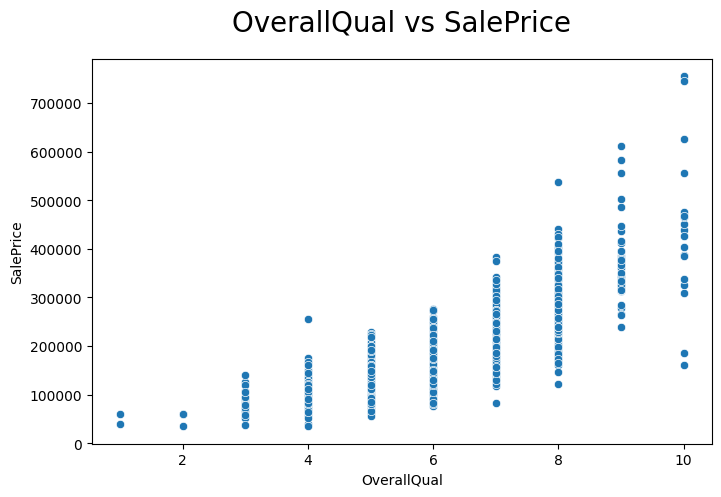

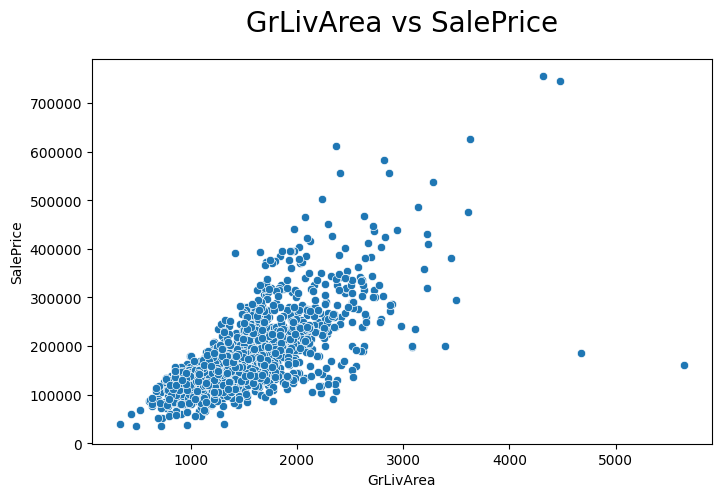

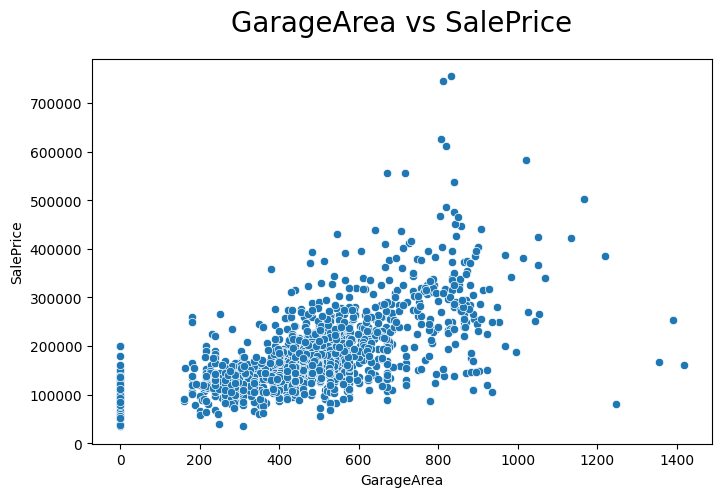

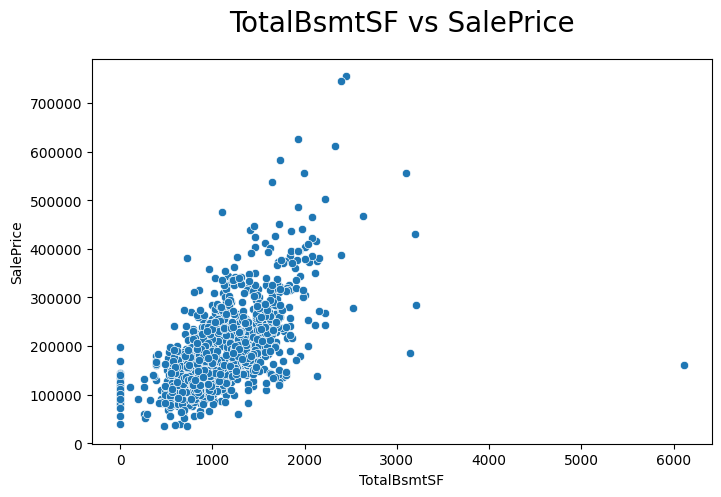

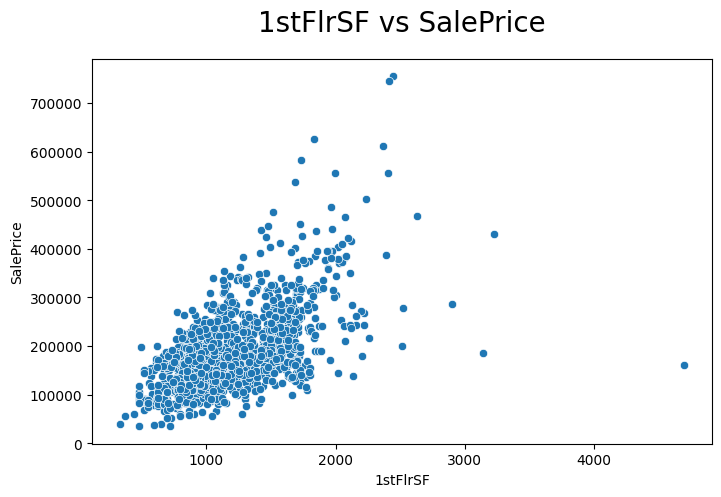

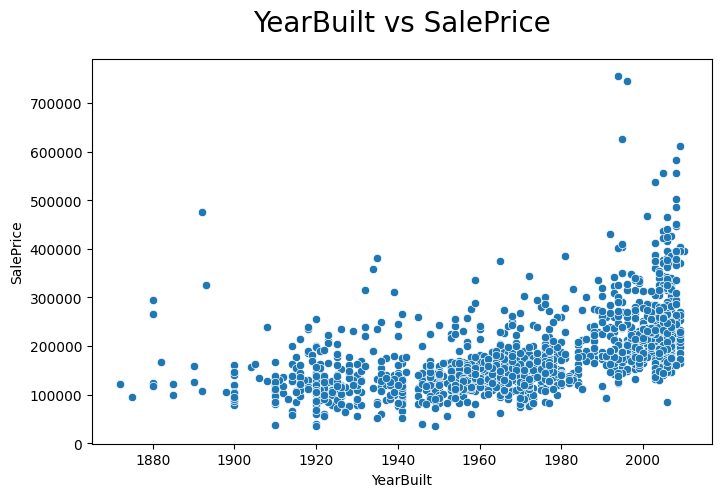

In [19]:
for col in top_correlations_cols:
    plt.figure(figsize=(8, 5))
    sns.scatterplot(data=df, x=col, y='SalePrice')
    plt.title(f"{col} vs SalePrice", fontsize=20, y=1.05)
    plt.xlabel(col)
    plt.ylabel('SalePrice')
    plt.show()
    print("\n\n")

# Data Visualization

We want to generate visualizations to explore the relationship between selected variables and the 'SalePrice'. It provides insights into variable distributions and their impact on the 'SalePrice'.

* Plotting Heatmap

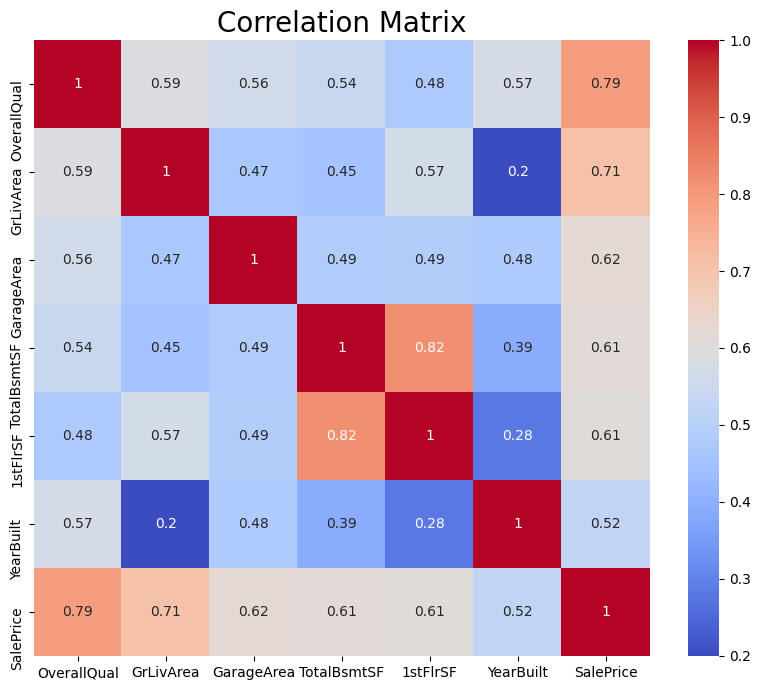

In [20]:
def plot_heatmap(data):
    plt.figure(figsize=(10, 8))
    sns.heatmap(data, annot=True, cmap='coolwarm', square=True)
    plt.title("Correlation Matrix", fontsize=20)
    plt.show()

plot_heatmap(correlation_data)

* Plotting Pairplot

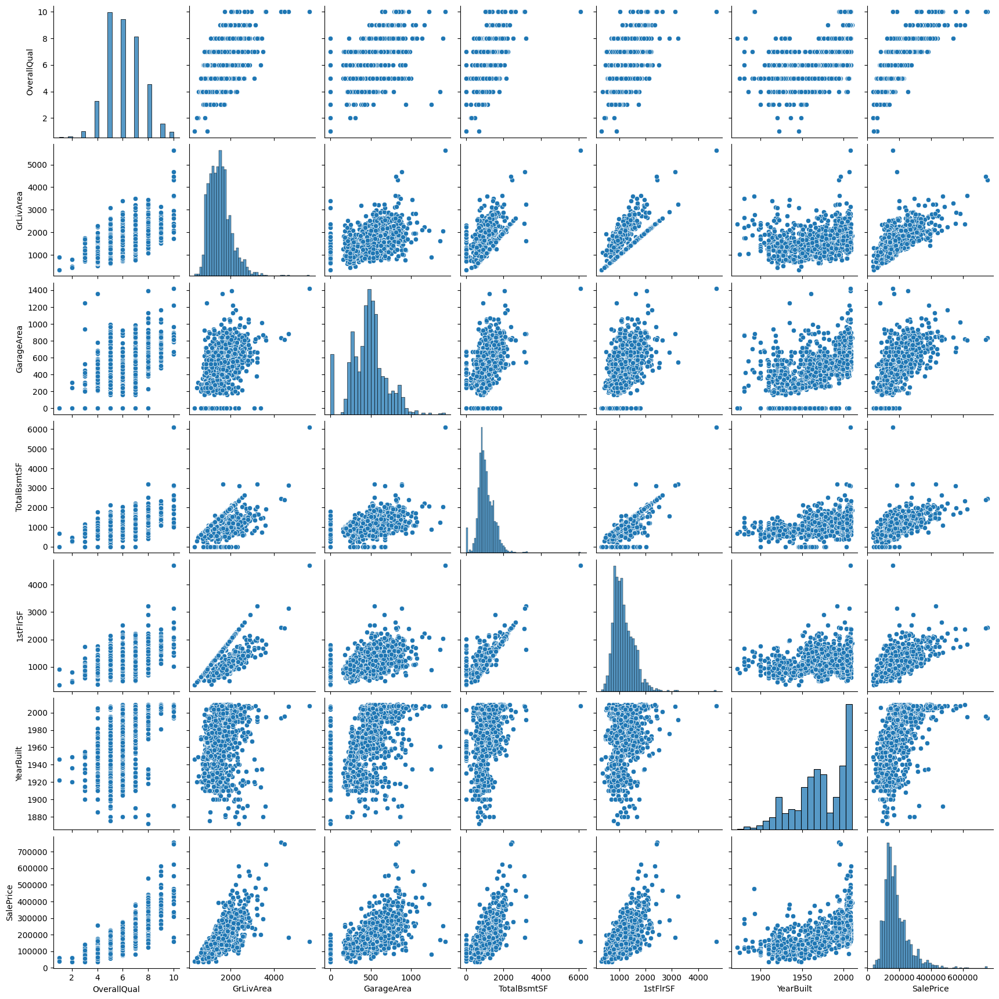

In [21]:
def plot_pairplot(data, variables):
    sns.pairplot(data[variables + [target_var]])
    plt.show()
    
target_var = 'SalePrice'
plot_pairplot(df, relevant_variables)

* Plotting Violin Plots

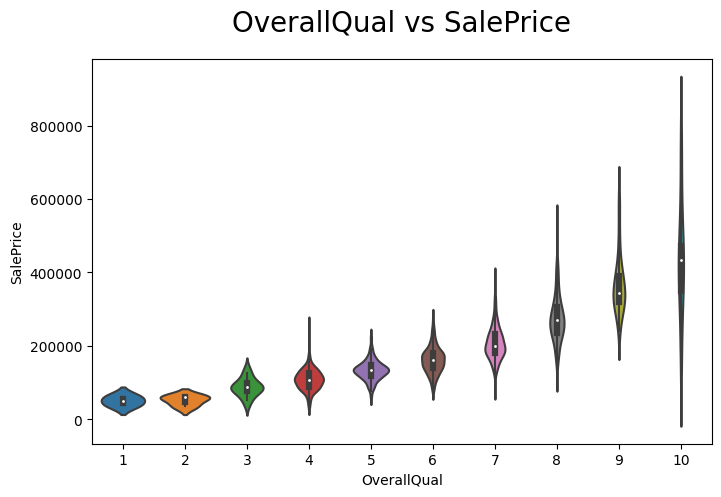

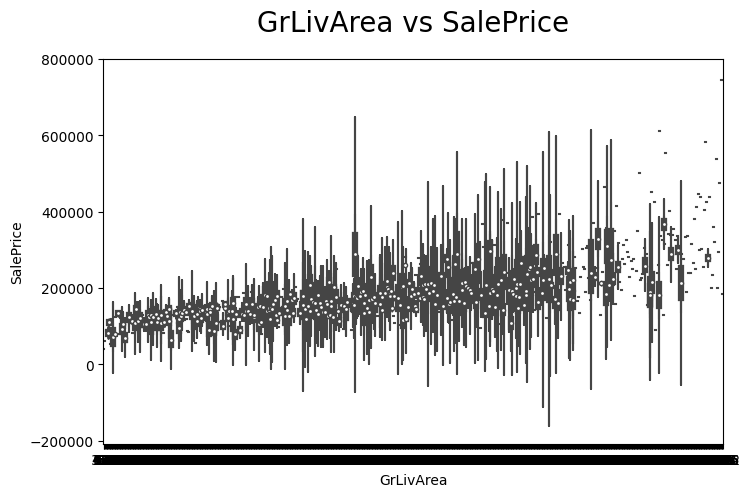

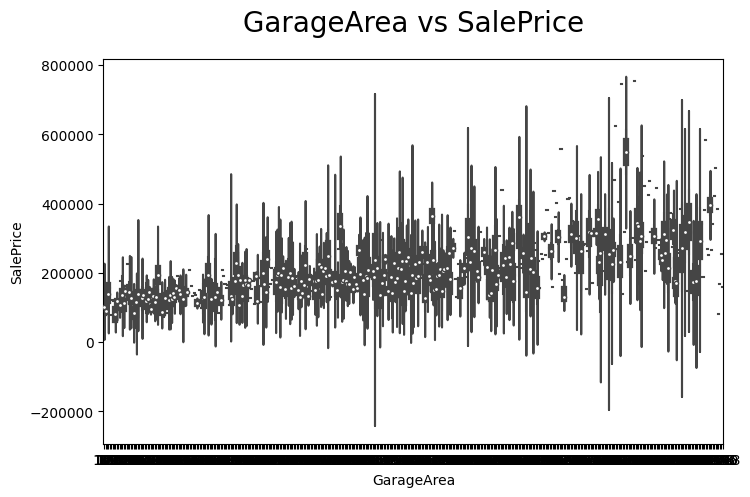

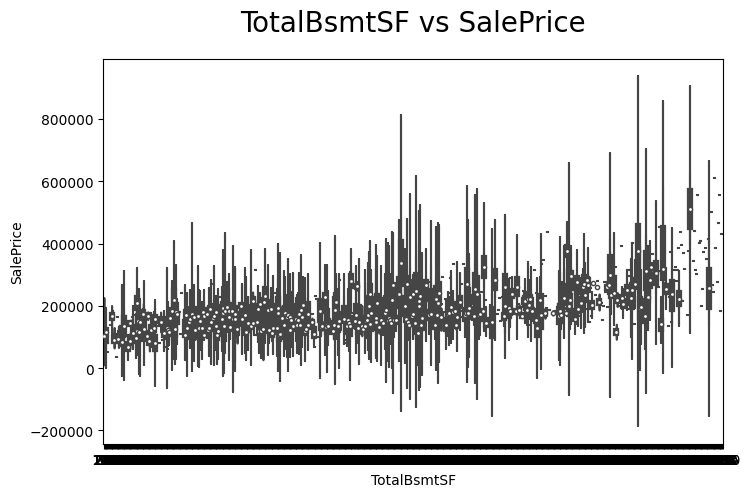

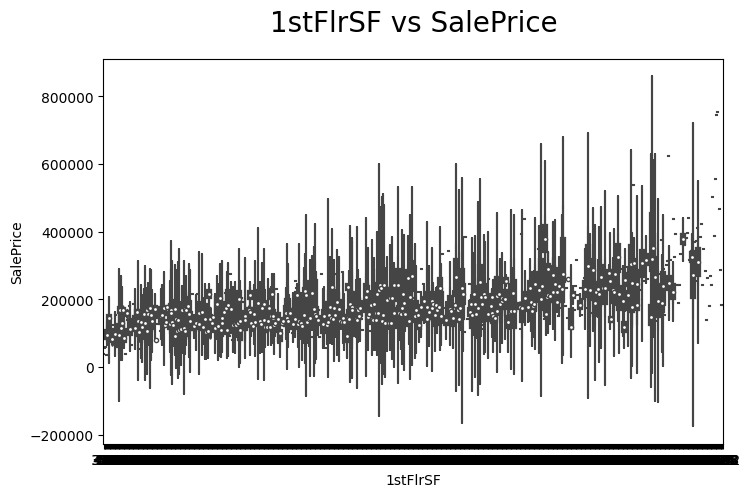

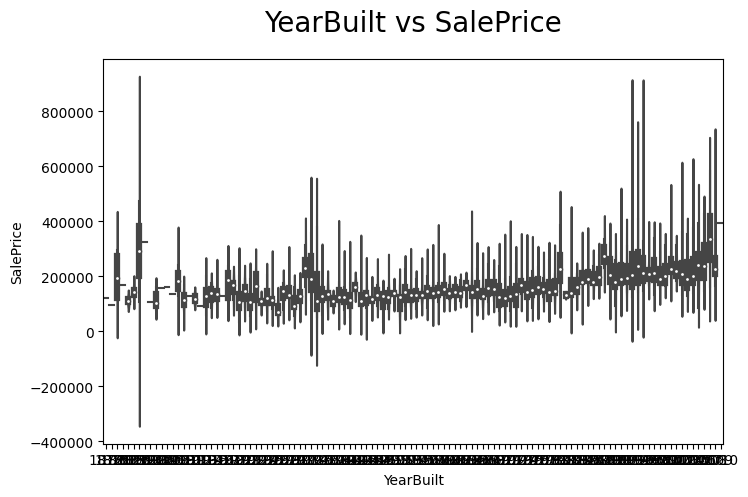

In [23]:
def plot_violin_plots(data, variables):
    for variable in variables:
        plt.figure(figsize=(8, 5))
        sns.violinplot(data=data, x=variable, y=target_var)
        plt.title(f"{variable} vs {target_var}", fontsize=20, y=1.05)
        plt.xlabel(variable)
        plt.ylabel(target_var)
        plt.show()

plot_violin_plots(df, relevant_variables)


* Plotting Distribution Plots

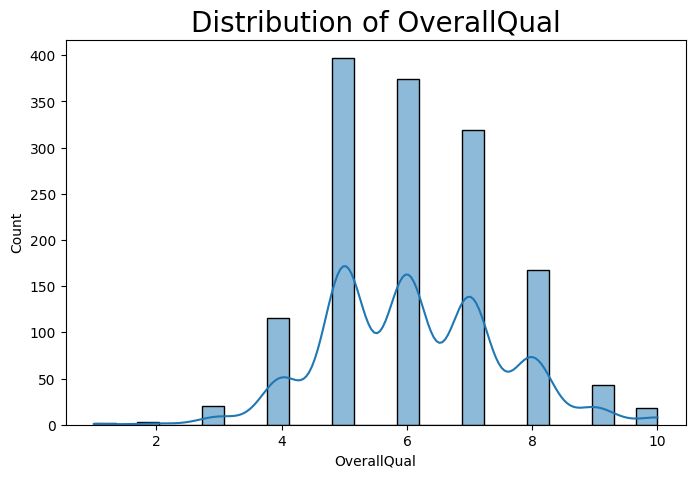

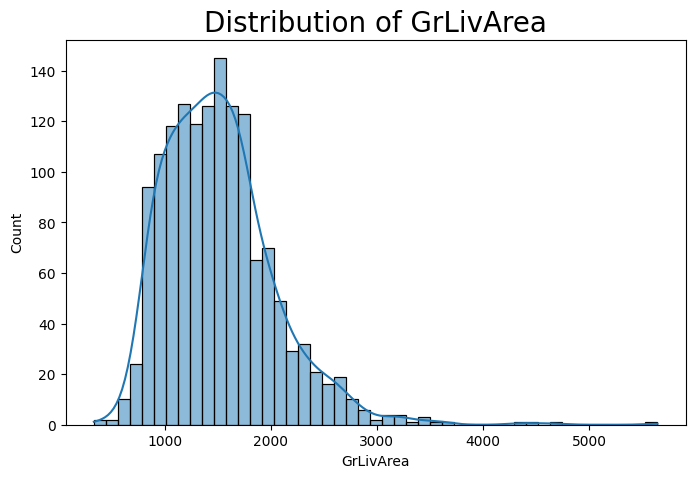

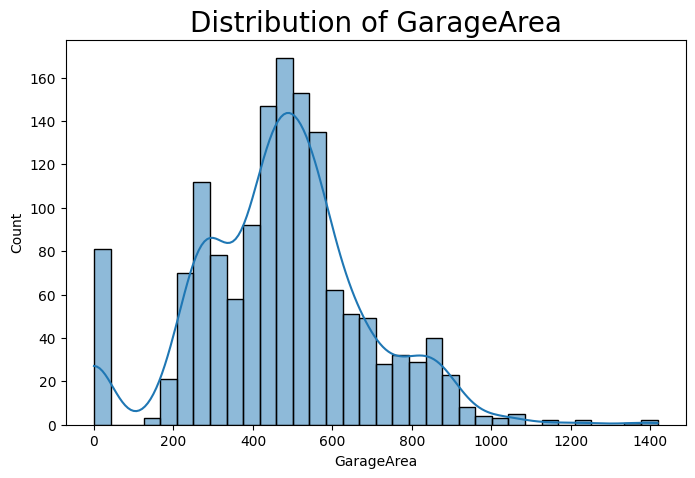

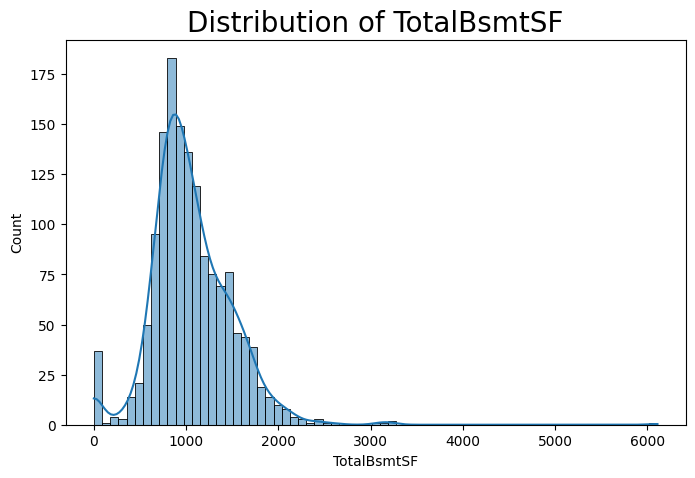

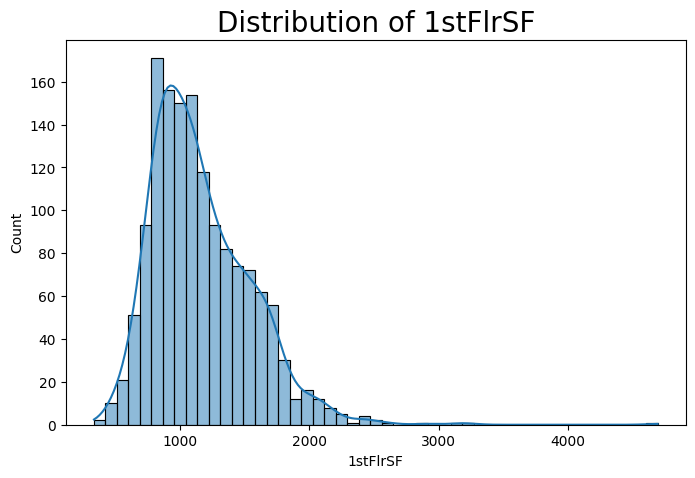

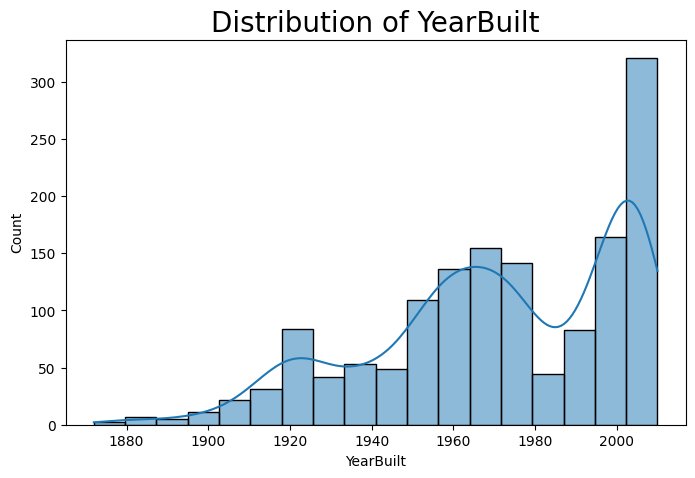

In [24]:
def plot_distribution_plots(data, variables):
    for variable in variables:
        plt.figure(figsize=(8, 5))
        sns.histplot(data=data, x=variable, kde=True)
        plt.title(f"Distribution of {variable}", fontsize=20)
        plt.xlabel(variable)
        plt.ylabel('Count')
        plt.show()

plot_distribution_plots(df, relevant_variables)

# Conclusions

Based on correlation and plot analysis, the following observations have been made to address the first business question regarding *** the correlation between house attributes and the typical Sale Price ***:

* The Sale Price of a house tends to be higher for properties with certain attributes.
* Overall Quality of the house has the strongest correlation with Sale Price, indicating that houses with higher quality generally command higher prices.
* Variables such as ** Above Ground Living Area **, ** Garage Area **, ** Total Basement Square Footage **, and ** First Floor Square Footage ** also show strong positive correlations with Sale Price.
* Other variables, such as ** Year Built **, exhibit moderate positive correlations with Sale Price.

---